In [1]:
import pandas as pd
import numpy as np

In [2]:
spotify_df = pd.read_csv('csv.csv')
spotify_df.head()
spotify_df.columns.unique()

Index(['Spotify ID', 'Artist IDs', 'Track Name', 'Album Name',
       'Artist Name(s)', 'Release Date', 'Duration (ms)', 'Popularity',
       'Added By', 'Added At', 'Genres', 'Danceability', 'Energy', 'Key',
       'Loudness', 'Mode', 'Speechiness', 'Acousticness', 'Instrumentalness',
       'Liveness', 'Valence', 'Tempo', 'Time Signature'],
      dtype='object')

In [3]:
spotify_df[spotify_df['Genres']=='alternative rock']

,Spotify ID,Artist IDs,Track Name,Album Name,Artist Name(s),Release Date,Duration (ms),Popularity,Added By,Added At,...,Key,Loudness,Mode,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Time Signature


**Link to make dataset:**
https://exportify.net/#playlists


In [4]:
spotify_df['Time Signature'].unique()

array([4, 5, 3])

In [5]:
spotify_df = spotify_df.drop(columns=('Added By'))

In [6]:
len(spotify_df)

149

In [7]:
spotify_df.head()

,Spotify ID,Artist IDs,Track Name,Album Name,Artist Name(s),Release Date,Duration (ms),Popularity,Added At,Genres,...,Key,Loudness,Mode,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Time Signature
0,5nNmj1cLH3r4aA4XDJ2bgY,4QQgXkCYTt3BlENzhyNETg,September,The Eternal Dance,"Earth, Wind & Fire",1992-09-08,214826,1,2017-10-09T22:07:43Z,"disco,funk,jazz funk,quiet storm,soul",...,9,-8.197,1,0.0302,0.114,0.000521,0.1830,0.980,125.941,4
1,4njseCGxWeZUksjhrqkleT,"3koiLjNrgRTNbOwViDipeA,75jNCko3SnEMI5gwGqrbb8",Ain't No Mountain High Enough - Mono Version,Anthology,"Marvin Gaye,Tammi Terrell",1995-01-01,148093,0,2017-10-09T22:09:13Z,"classic soul,funk,indie r&b,motown,northern so...",...,7,-6.005,1,0.0324,0.355,0.000932,0.1520,0.886,129.168,4
2,6jWkZvd1URGktyTTwcpPpB,3RwQ26hR2tJtA8F9p2n7jG,My Girl,The Temptations Sing Smokey,The Temptations,1965-01-01,165000,1,2017-10-09T22:09:38Z,"brill building pop,classic soul,funk,memphis s...",...,0,-10.720,1,0.0346,0.625,0.000000,0.0981,0.673,104.564,4
3,47l9wxr6RwgoTSfnseBRcf,73sIBHcqh3Z3NyqHKZ7FOL,Redbone,Redbone,Childish Gambino,2016-11-17,326880,0,2017-10-09T22:19:50Z,"atl hip hop,hip hop,rap",...,1,-10.454,1,0.1090,0.195,0.017300,0.1190,0.565,160.049,4
4,152lZdxL1OR0ZMW6KquMif,6LuN9FCkKOj5PcnpouEgny,Location,American Teen,Khalid,2017-04-27,219080,83,2017-10-09T22:23:46Z,"pop,pop r&b",...,1,-11.462,0,0.4250,0.330,0.000162,0.0898,0.326,80.126,4


---

In [8]:
import h5py
filename = "TRAAAAW128F429D538.h5"

with h5py.File(filename, "r") as f:
    # List all groups
    print("Keys: %s" % f.keys())
    a_group_key = list(f.keys())[0]

    # Get the data
    data = list(f[a_group_key])

Keys: <KeysViewHDF5 ['analysis', 'metadata', 'musicbrainz']>


In [9]:
data

['bars_confidence',
 'bars_start',
 'beats_confidence',
 'beats_start',
 'sections_confidence',
 'sections_start',
 'segments_confidence',
 'segments_loudness_max',
 'segments_loudness_max_time',
 'segments_loudness_start',
 'segments_pitches',
 'segments_start',
 'segments_timbre',
 'songs',
 'tatums_confidence',
 'tatums_start']

In [10]:
import h5py
import numpy as np
filename = 'TRAAAAW128F429D538.h5'
with h5py.File(filename,'r') as hdf:
    ls=list(hdf.keys())
    print('list of datasets in the file\n', ls)
    data = hdf.get('musicbrainz')
    df = np.array(data)
    print('Shape of dataset:\n',df.shape)
# lol what even are h5 files?

list of datasets in the file
 ['analysis', 'metadata', 'musicbrainz']
Shape of dataset:
 (3,)


In [11]:
df

array(['artist_mbtags', 'artist_mbtags_count', 'songs'], dtype='<U19')

----

In [12]:
from IPython.display import Audio
chopin_file = 'Chopin-waltz-in-a-minor.wav'
test_file = 'chopin_test.wav'

In [13]:
Audio(data=chopin_file, autoplay=False)

In [14]:
Audio(data=test_file, autoplay=False)

In [15]:
import librosa
import librosa.display

In [16]:
import matplotlib.pyplot as plt

In [17]:
audio, sfreq = librosa.load(chopin_file)
time = np.arange(0,len(audio))/sfreq

In [18]:
time

array([0.00000000e+00, 4.53514739e-05, 9.07029478e-05, ...,
       1.30794966e+02, 1.30795011e+02, 1.30795057e+02])

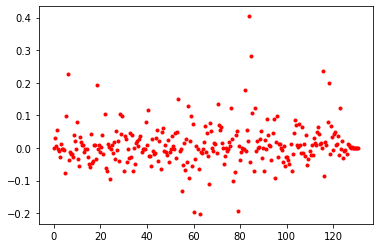

In [19]:
dot = [] # time of composition
point = [] # sound ampitude of composition
for i in range(0,len(time),10000):
    dot.append(time[i])
    point.append(audio[i])
plt.scatter(dot,point, marker='.', c='r')

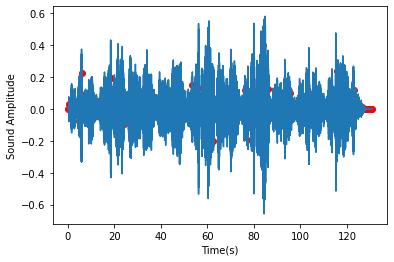

In [20]:
fig, ax = plt.subplots()
ax.plot(time,audio)
ax.set(xlabel='Time(s)',ylabel='Sound Amplitude', alpha=0.1)
plt.scatter(dot,point, c='r')
plt.show()

In [21]:
test_audio, sfreq2 = librosa.load(test_file)
time2 = np.arange(0,len(test_audio))/sfreq2

In [22]:
time2

array([0.00000000e+00, 4.53514739e-05, 9.07029478e-05, ...,
       3.49458957e+01, 3.49459410e+01, 3.49459864e+01])

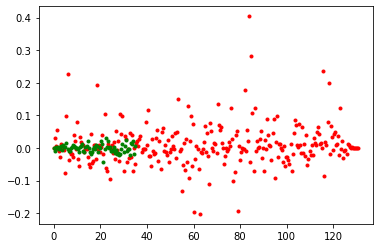

In [23]:
dot2 = []
point2 = []
for i in range(0,len(time2),10000):
    dot2.append(time2[i])
    point2.append(test_audio[i])
plt.scatter(dot,point, marker='.', c='r')
plt.scatter(dot2,point2, marker='.', c='green')
plt.show()

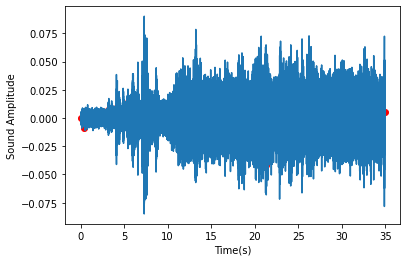

In [24]:
fig, ax2 = plt.subplots()
ax2.plot(time2,test_audio)
ax2.set(xlabel='Time(s)',ylabel='Sound Amplitude', alpha=0.1)
plt.scatter(dot2,point2, c='r')
plt.show()

---------

In [25]:
frame_size = 2048
hop_size = 512
s_scale = librosa.stft(audio, n_fft=frame_size, hop_length=hop_size)
s_scale.shape

(1025, 5633)

In [26]:
type(s_scale[0][0])

numpy.complex64

In [27]:
y_scale = np.abs(s_scale)**2
y_scale.shape

(1025, 5633)

In [28]:
type(y_scale[0][0])

numpy.float32

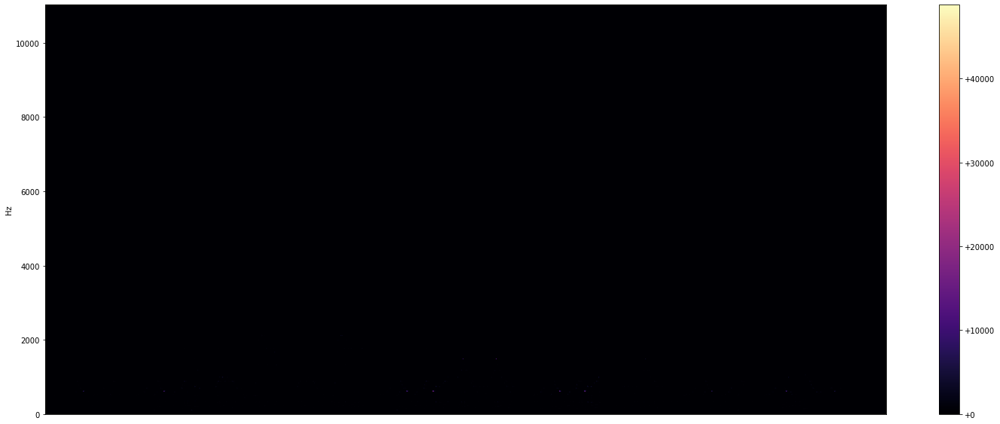

In [29]:
def plot_spect(y, sr, hop_length, y_axis='linear'):
    plt.figure(figsize=(25,10))
    librosa.display.specshow(y, sr=sr, hop_length=hop_length, y_axis=y_axis)
    plt.colorbar(format='%+2.f')
plot_spect(y_scale,sfreq,hop_size)

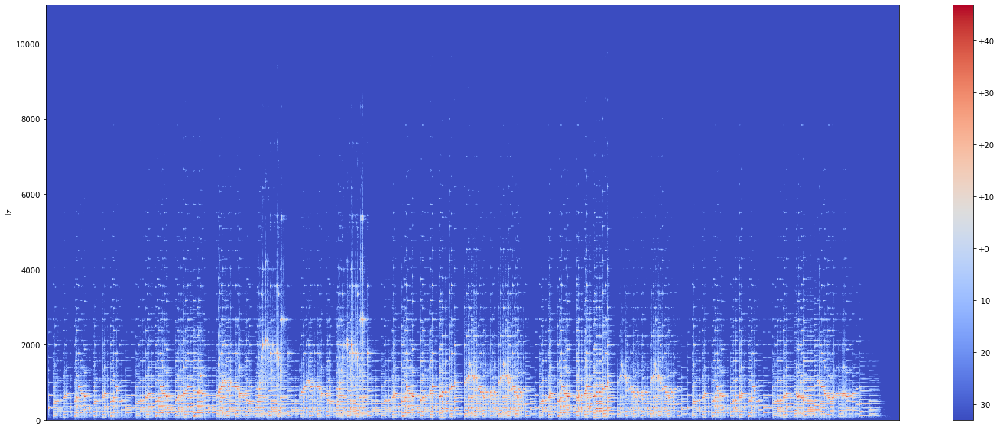

In [30]:
y_log_scale = librosa.power_to_db(y_scale)
plot_spect(y_log_scale,sfreq,hop_size)

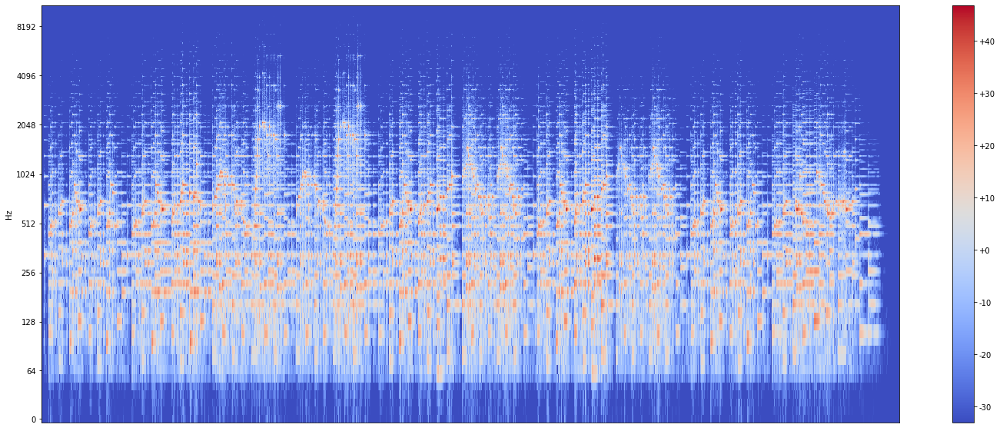

In [31]:
plot_spect(y_log_scale,sfreq,hop_size,y_axis='log')